In [43]:
import os
import numpy as np
import torch
from tqdm.auto import tqdm, trange
from matplotlib import pyplot as plt
import seaborn as sn
from transformers import CLIPFeatureExtractor, CLIPVisionModelWithProjection

from dataset import LitAwA2DM, AwA2Dataset

In [2]:
os.environ['CUDA_VISIBLE_DEVICES'] = "3"
device = torch.device('cuda')

In [3]:
dset = AwA2Dataset('/home/andrewbai/data', split='valid')

In [4]:
len(dset)

7481

In [6]:
dm = LitAwA2DM(root_dir='/home/andrewbai/data/', 
               bsize=64, num_workers=8,
               attr_binarize=True)

In [7]:
clip_projector = CLIPVisionModelWithProjection.from_pretrained("openai/clip-vit-base-patch32")

Some weights of the model checkpoint at openai/clip-vit-base-patch32 were not used when initializing CLIPVisionModelWithProjection: ['text_model.encoder.layers.3.layer_norm2.bias', 'text_model.encoder.layers.8.layer_norm2.weight', 'text_model.encoder.layers.6.layer_norm2.weight', 'text_model.encoder.layers.0.self_attn.out_proj.weight', 'text_model.encoder.layers.4.self_attn.out_proj.bias', 'text_model.encoder.layers.3.self_attn.k_proj.weight', 'text_model.encoder.layers.2.mlp.fc1.bias', 'text_model.encoder.layers.5.layer_norm1.bias', 'text_model.encoder.layers.8.self_attn.out_proj.bias', 'text_model.encoder.layers.6.self_attn.out_proj.bias', 'text_model.encoder.layers.11.layer_norm2.weight', 'text_model.encoder.layers.9.layer_norm1.weight', 'text_model.encoder.layers.6.self_attn.k_proj.bias', 'text_model.encoder.layers.9.self_attn.out_proj.bias', 'text_model.encoder.layers.9.self_attn.v_proj.weight', 'text_model.encoder.layers.4.layer_norm2.bias', 'text_model.encoder.layers.6.layer_nor

In [8]:
clip_projector.to(device)

CLIPVisionModelWithProjection(
  (vision_model): CLIPVisionTransformer(
    (embeddings): CLIPVisionEmbeddings(
      (patch_embedding): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
      (position_embedding): Embedding(50, 768)
    )
    (pre_layrnorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0): CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=768, out_features=768, bias=True)
            (v_proj): Linear(in_features=768, out_features=768, bias=True)
            (q_proj): Linear(in_features=768, out_features=768, bias=True)
            (out_proj): Linear(in_features=768, out_features=768, bias=True)
          )
          (layer_norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=768, out_features=3072, bias=True)
  

In [10]:
emb_xs, ys, cs = [], [], []
with torch.no_grad():
    for xs_, cs_, ys_ in tqdm(dm.val_dataloader()):
        xs_ = xs_.to(device)
        emb_xs_ = clip_projector(xs_)['image_embeds']
        emb_xs.append(emb_xs_.cpu().numpy())
        cs.append(cs_.cpu().numpy())
        ys.append(ys_.cpu().numpy())
emb_xs = np.concatenate(emb_xs, axis=0)
cs = np.concatenate(cs, axis=0)
ys = np.concatenate(ys, axis=0)

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbacbe03550>
Traceback (most recent call last):
  File "/home/andrewbai/miniconda3/envs/hf/lib/python3.8/site-packages/torch/utils/data/dataloader.py", line 1466, in __del__
    self._shutdown_workers()
  File "/home/andrewbai/miniconda3/envs/hf/lib/python3.8/site-packages/torch/utils/data/dataloader.py", line 1430, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/home/andrewbai/miniconda3/envs/hf/lib/python3.8/multiprocessing/process.py", line 149, in join
    res = self._popen.wait(timeout)
  File "/home/andrewbai/miniconda3/envs/hf/lib/python3.8/multiprocessing/popen_fork.py", line 44, in wait
    if not wait([self.sentinel], timeout):
  File "/home/andrewbai/miniconda3/envs/hf/lib/python3.8/multiprocessing/connection.py", line 931, in wait
    ready = selector.select(timeout)
  File "/home/andrewbai/miniconda3/envs/hf/lib/python3.8/selectors.py", line 415, in select
    fd_

  0%|          | 0/117 [00:00<?, ?it/s]

In [99]:
emb_xs /= np.linalg.norm(emb_xs, axis=-1, keepdims=True)

In [104]:
zero_shot_weights = np.load('./prompts/AwA2_constructed_prompts.npy')
zero_shot_weights /= np.linalg.norm(zero_shot_weights, axis=-1, keepdims=True)
zero_shot_weights.shape

(85, 512)

In [105]:
zero_shot_cs = emb_xs @ zero_shot_weights.T
zero_shot_cs.shape

(7481, 85)

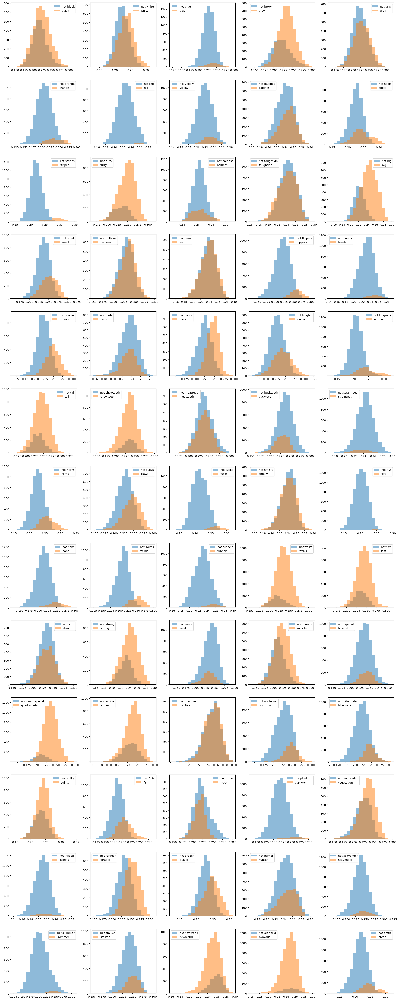

In [106]:
fig, axs = plt.subplots(13, 5, figsize=(5 * 5, 5 * 13))
for i, ax in enumerate(axs.flat):
    bins = np.linspace(zero_shot_cs[:, i].min(), zero_shot_cs[:, i].max(), 20)
    ax.hist(zero_shot_cs[:, i][cs[:, i] == 0], alpha=0.5, bins=bins, label=f"not {dset.attr_names[i]}")
    ax.hist(zero_shot_cs[:, i][cs[:, i] == 1], alpha=0.5, bins=bins, label=dset.attr_names[i])
    ax.legend()

In [107]:
np.mean(cs == (zero_shot_cs > np.expand_dims(np.median(zero_shot_cs, axis=-1), -1)))

0.6674854730021937

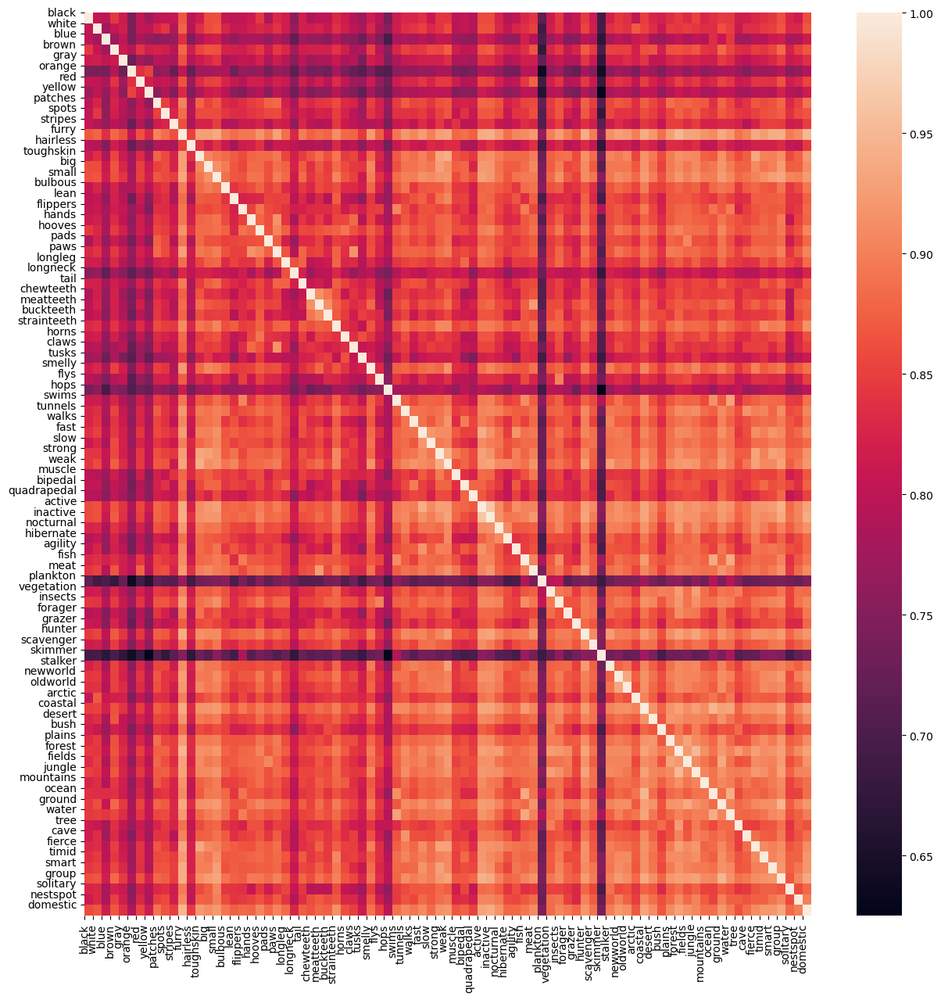

In [108]:
pw_concept_similarity = zero_shot_weights @ zero_shot_weights.T
plt.figure(figsize=(15, 15))
sn.heatmap(pw_concept_similarity)
plt.xticks(np.arange(len(dset.attr_names)), labels=dset.attr_names, rotation=90)
plt.yticks(np.arange(len(dset.attr_names)), labels=dset.attr_names, rotation=0)
plt.show()

In [109]:
zero_shot_concept_weights = np.load('./prompts/AwA2_human_prompts_v2.npy')
zero_shot_concept_weights /= np.linalg.norm(zero_shot_concept_weights, axis=-1, keepdims=True)
zero_shot_concept_weights.shape

(85, 512)

In [110]:
zero_shot_cs = emb_xs @ zero_shot_concept_weights.T
zero_shot_cs.shape

(7481, 85)

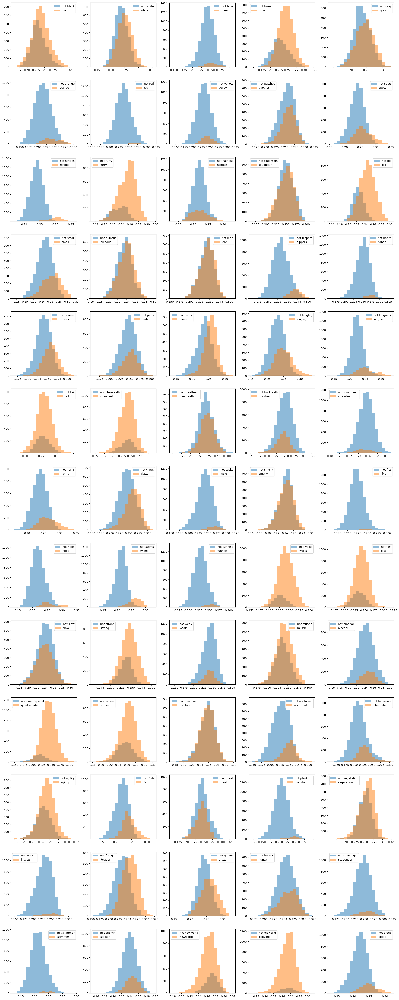

In [111]:
fig, axs = plt.subplots(13, 5, figsize=(5 * 5, 5 * 13))
for i, ax in enumerate(axs.flat):
    bins = np.linspace(zero_shot_cs[:, i].min(), zero_shot_cs[:, i].max(), 20)
    ax.hist(zero_shot_cs[:, i][cs[:, i] == 0], alpha=0.5, bins=bins, label=f"not {dset.attr_names[i]}")
    ax.hist(zero_shot_cs[:, i][cs[:, i] == 1], alpha=0.5, bins=bins, label=dset.attr_names[i])
    ax.legend()

In [112]:
np.mean(cs == (zero_shot_cs > np.expand_dims(np.median(zero_shot_cs, axis=-1), -1)))

0.644550508346635

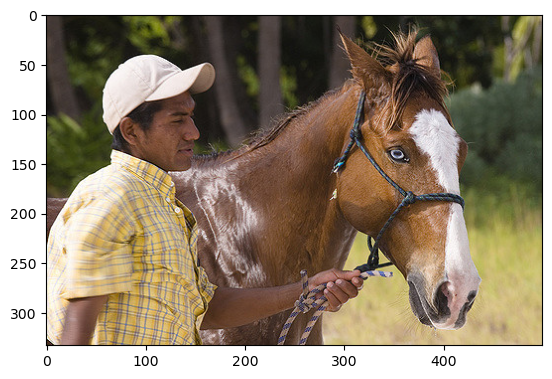

0.23145321 1


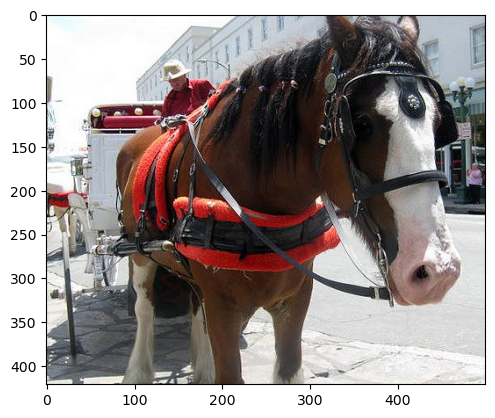

0.2313147 1


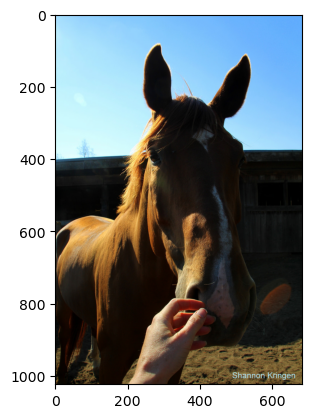

0.24401292 1


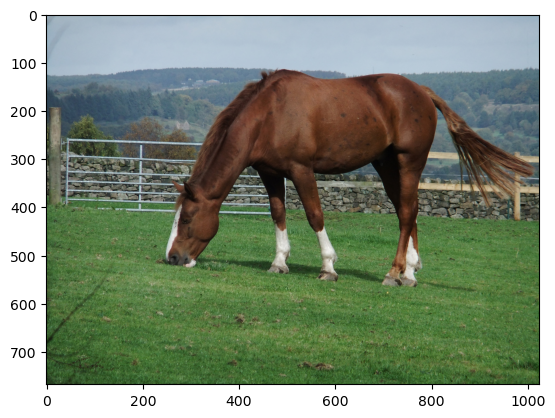

0.22858031 1


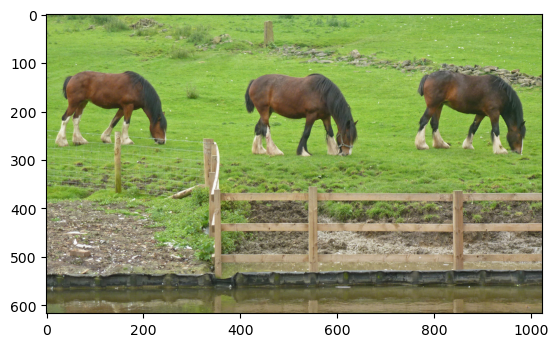

0.2326441 1


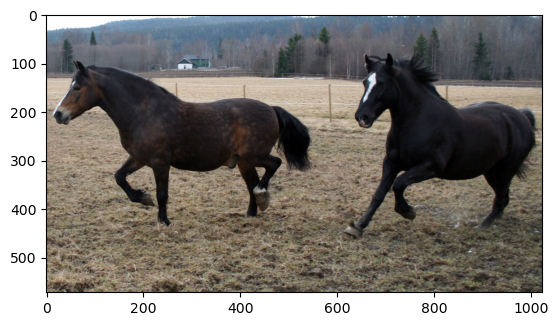

0.26599878 1


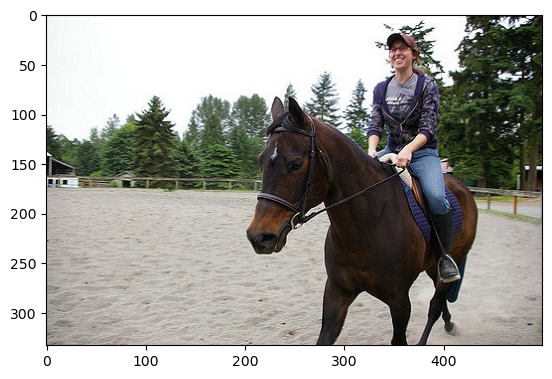

0.23550001 1


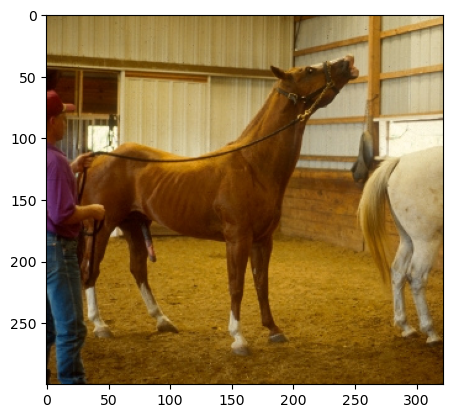

0.19998828 1


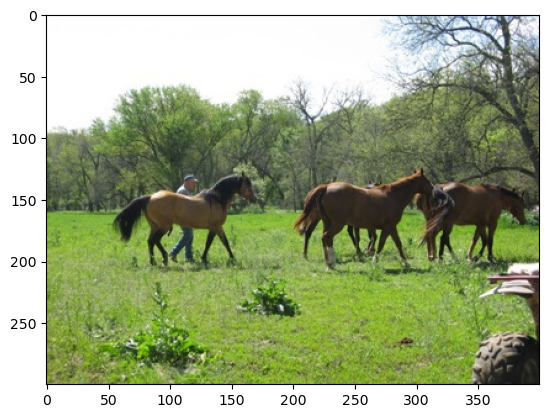

0.22042175 1


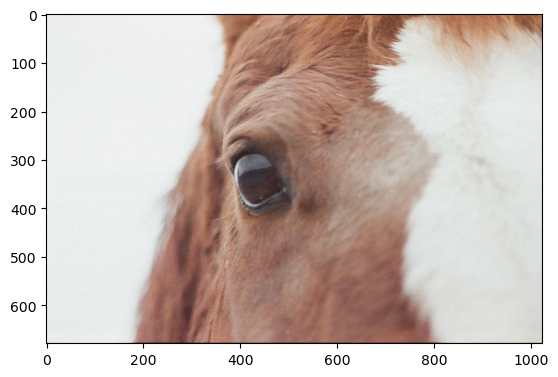

0.21758717 1


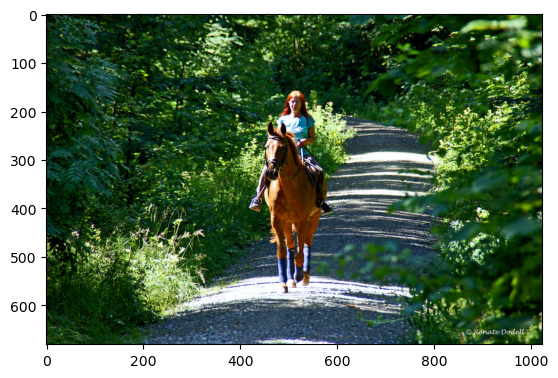

0.22141461 1


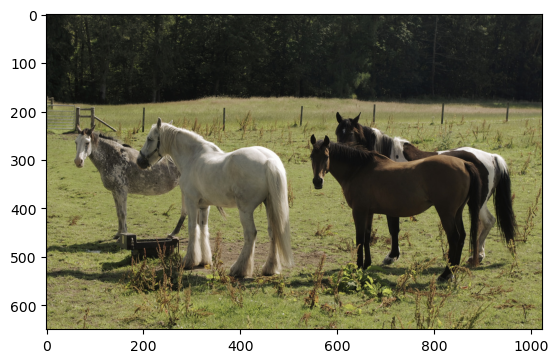

0.22955166 1


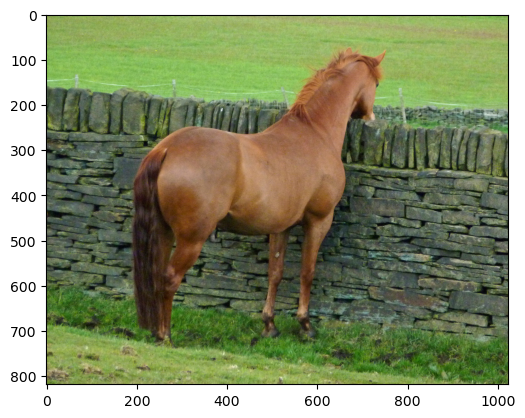

0.2578446 1


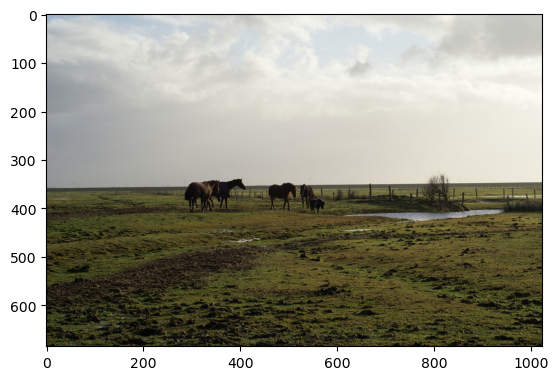

0.22070864 1


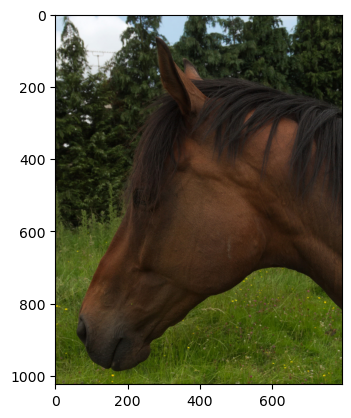

0.274866 1


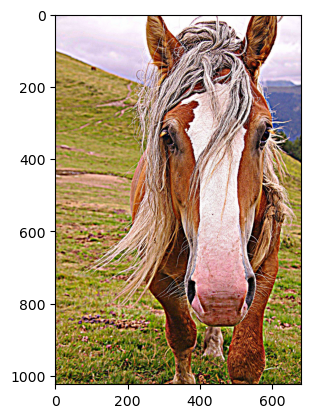

0.25219524 1


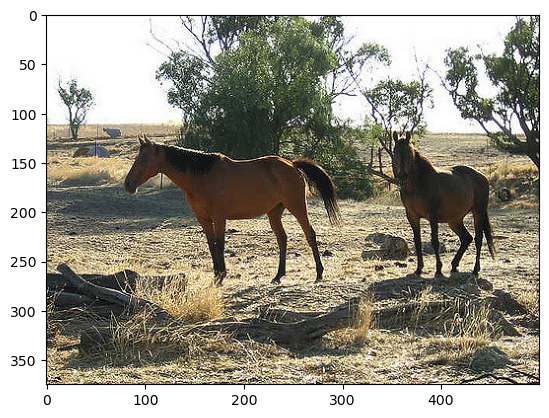

0.22734025 1


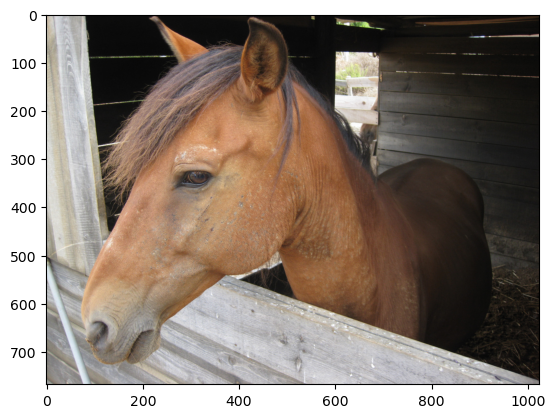

0.24553338 1


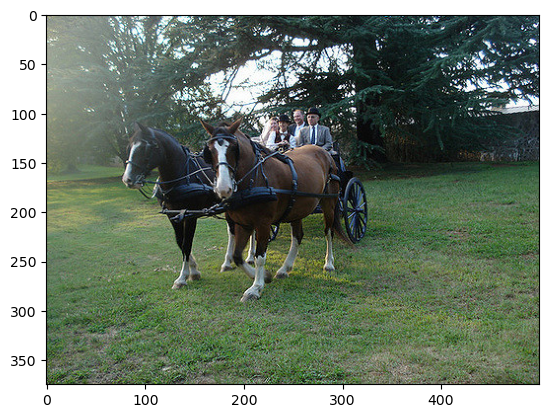

0.2330209 1


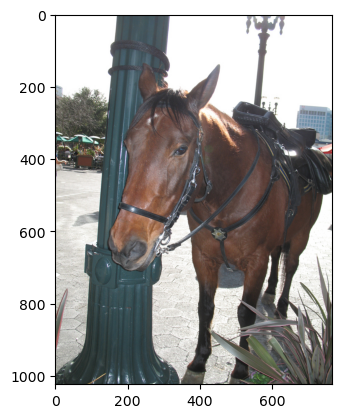

0.24890047 1


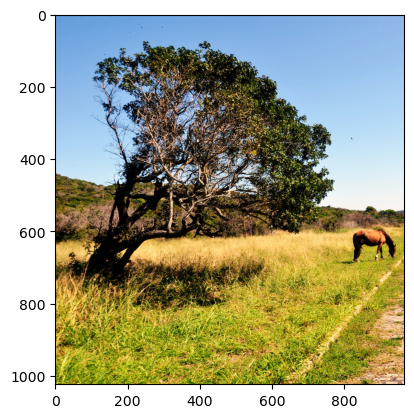

0.24397129 1


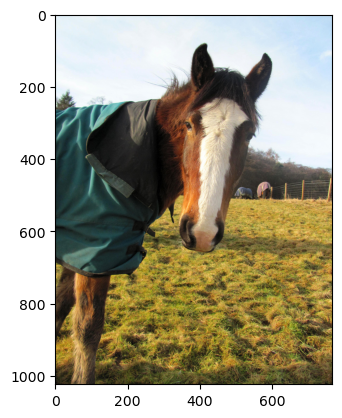

0.2161204 1


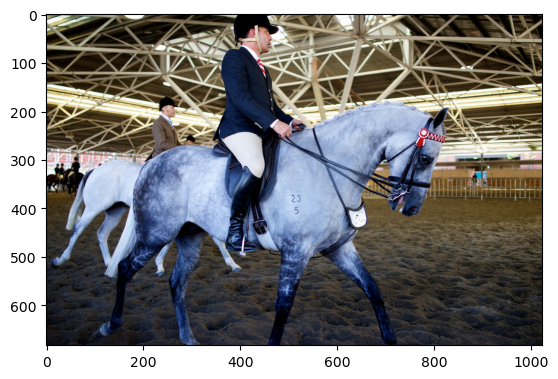

0.24532726 1


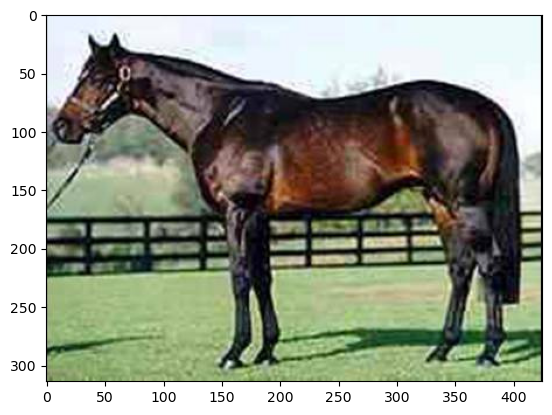

0.2838577 1


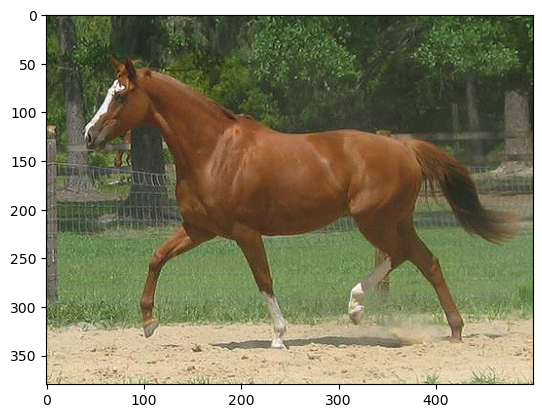

0.23775509 1


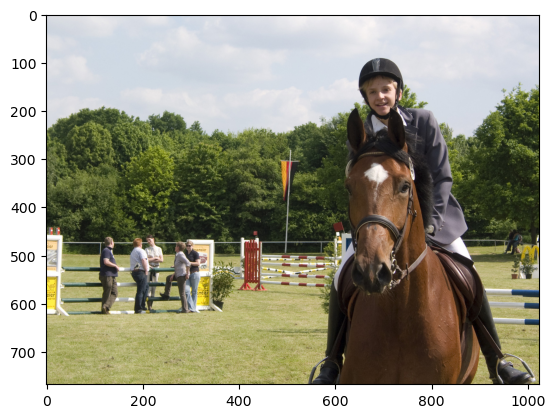

0.19997999 1


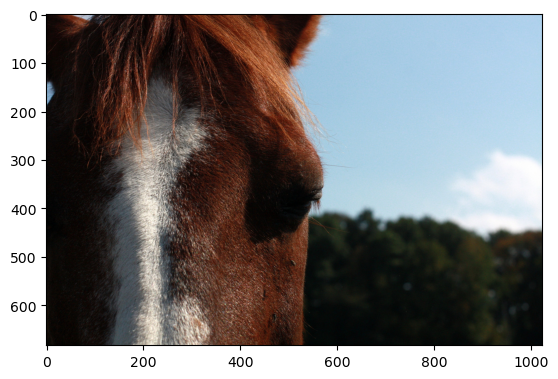

0.25251222 1


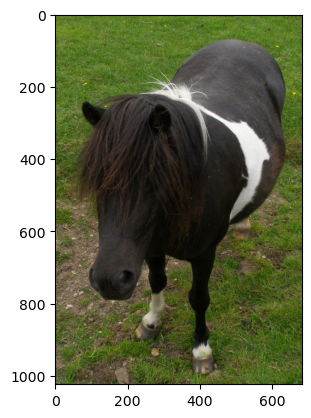

0.30606773 1


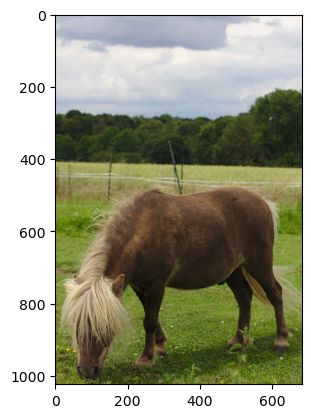

0.26962814 1


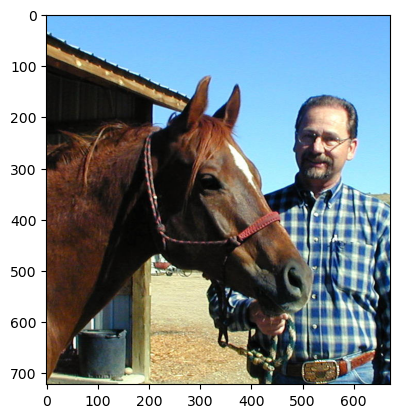

0.24244712 1


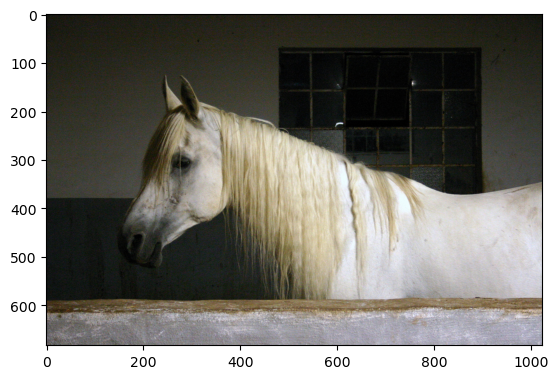

0.27720252 1


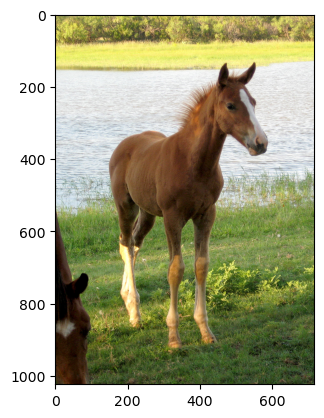

0.24497999 1


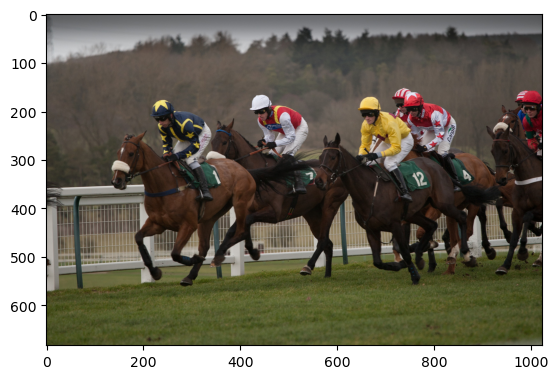

0.18940625 1


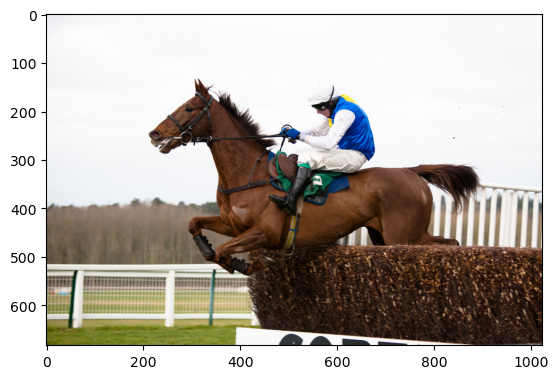

0.18230087 1


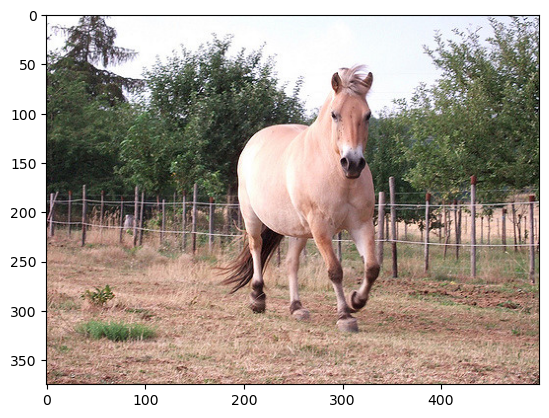

0.24122137 1


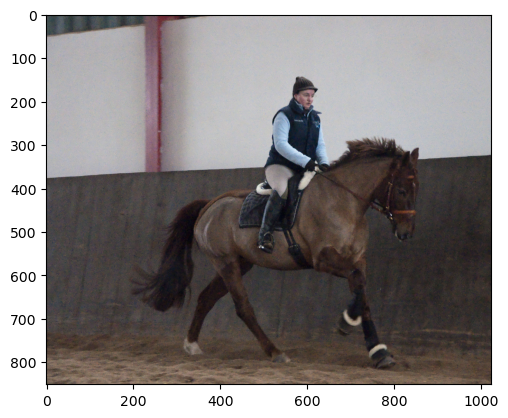

0.22305682 1


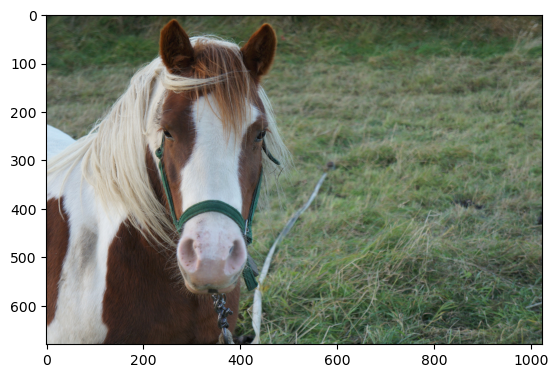

0.24119599 1


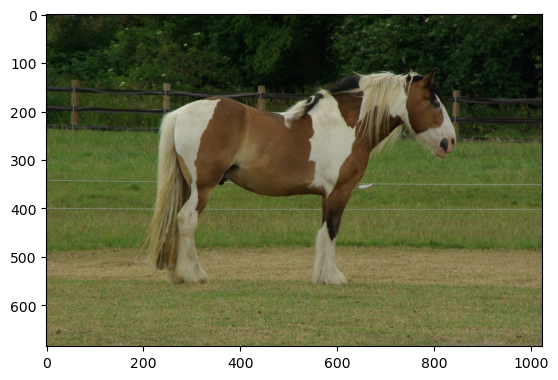

0.24223103 1


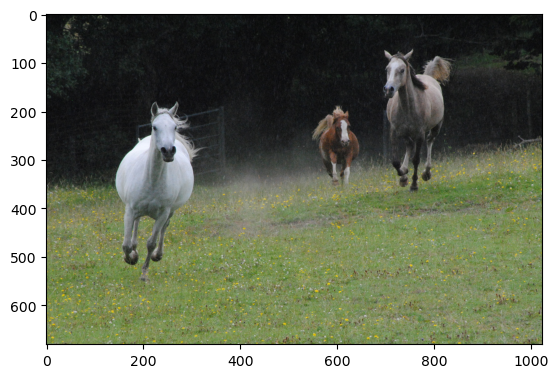

0.25545713 1


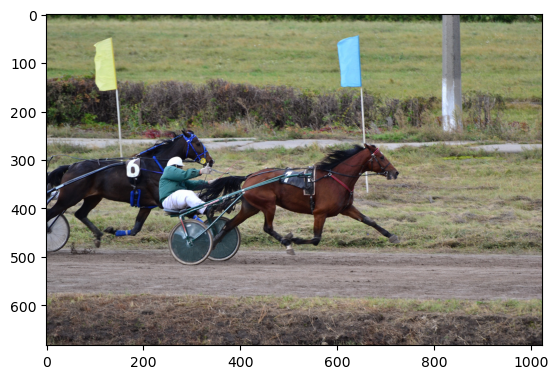

0.23643999 1


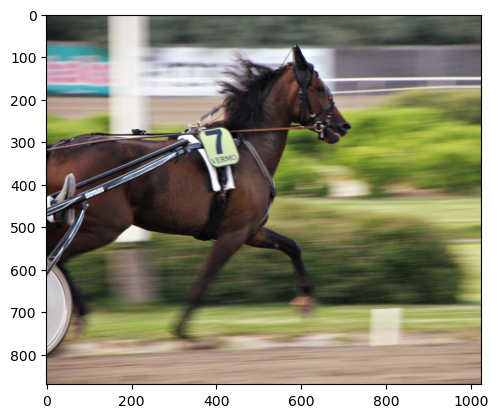

0.28220806 1


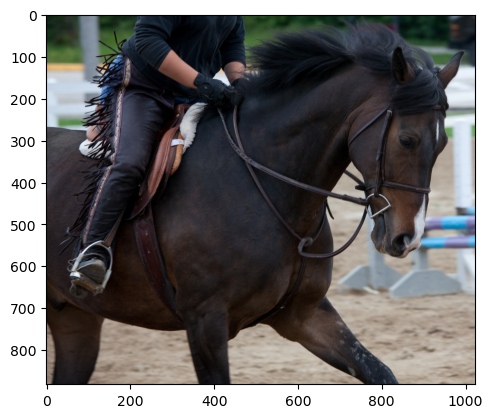

0.26860976 1


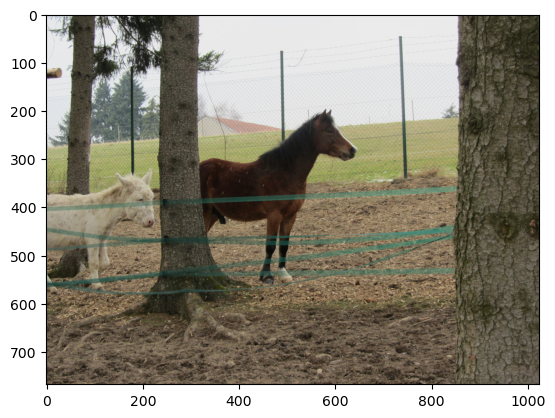

0.2679097 1


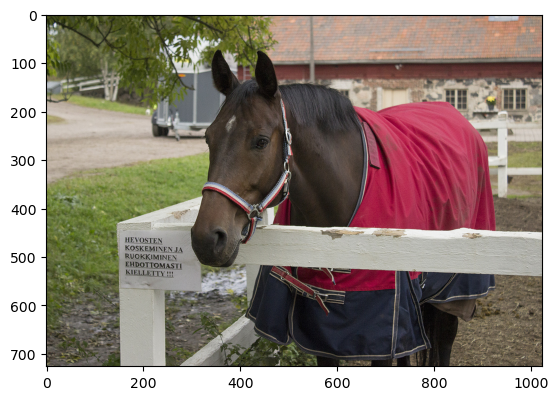

0.26844543 1


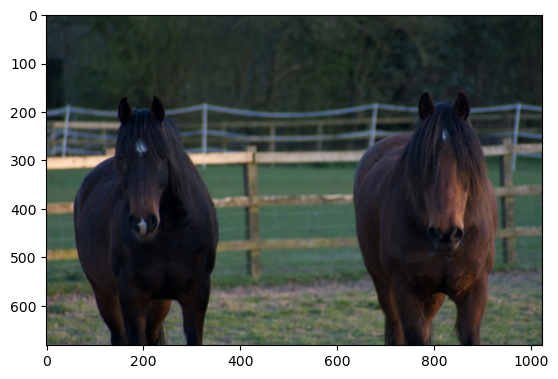

0.2641592 1


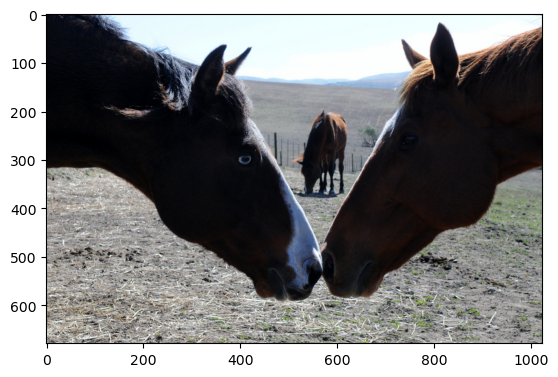

0.24491012 1


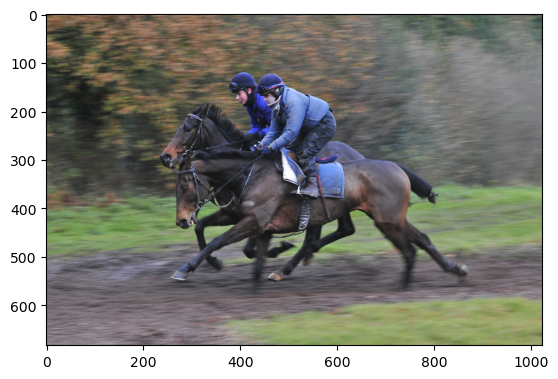

0.22638609 1


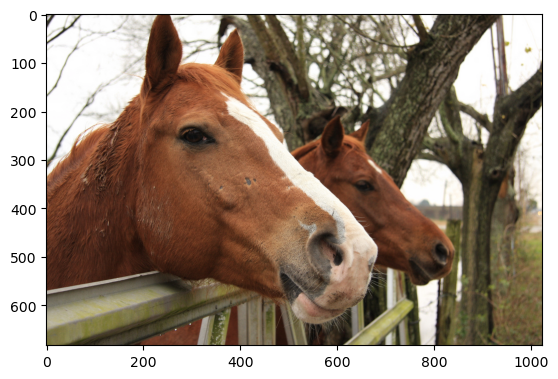

0.21569274 1


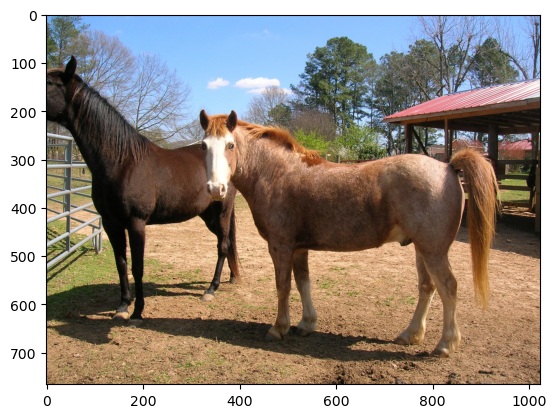

0.20648435 1


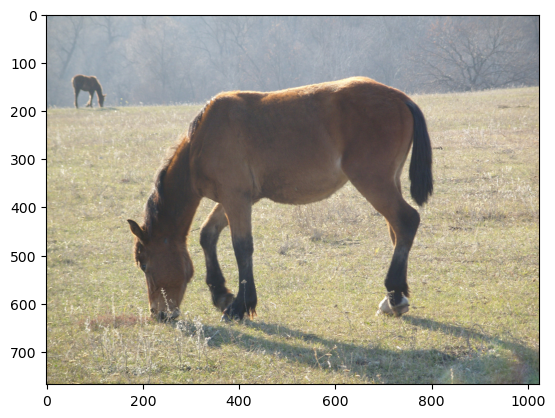

0.2609474 1


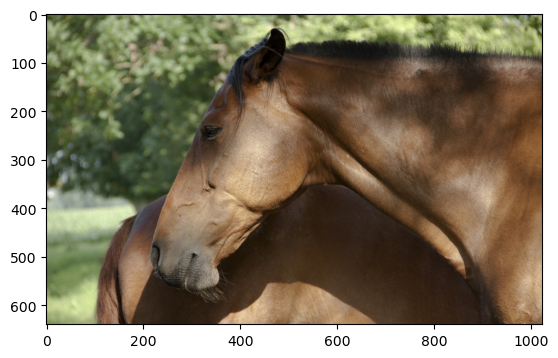

0.24796228 1


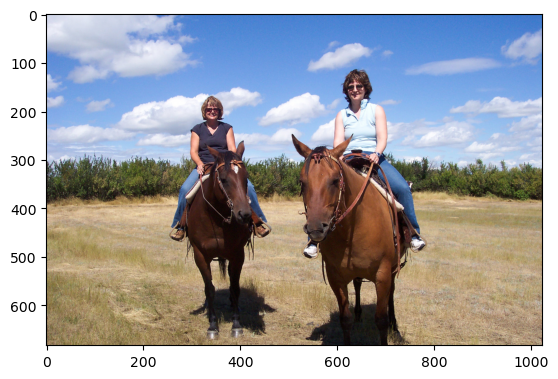

0.20353271 1


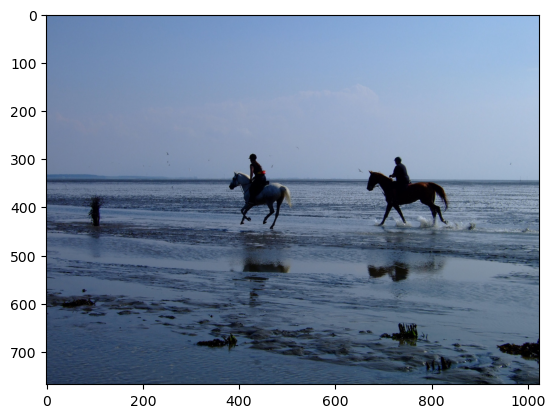

0.22510475 1


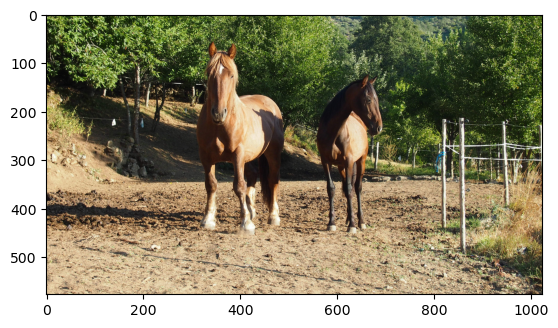

0.26110727 1


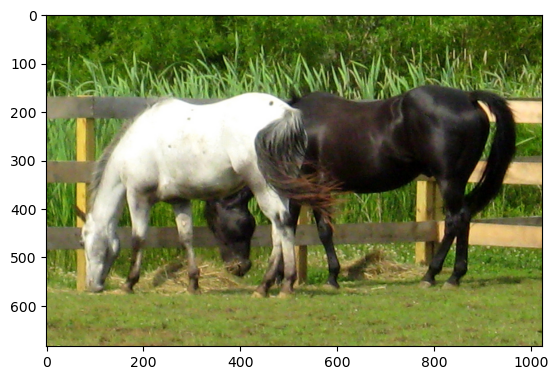

0.2668473 1


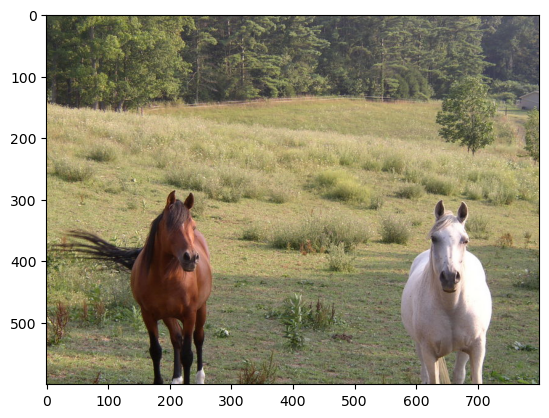

0.2488125 1


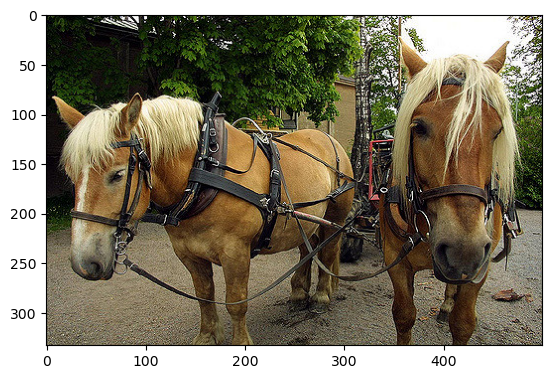

0.1947857 1


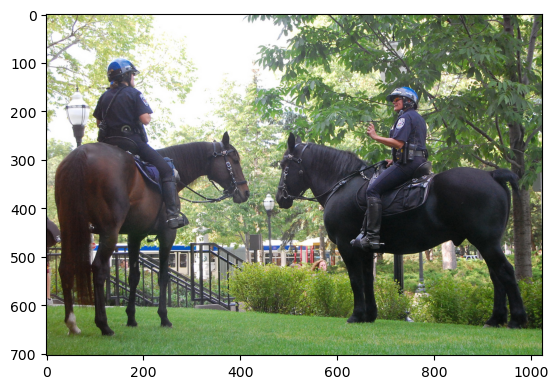

0.22540219 1


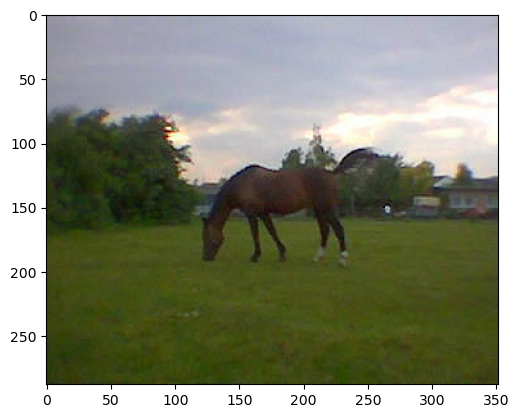

0.2687086 1


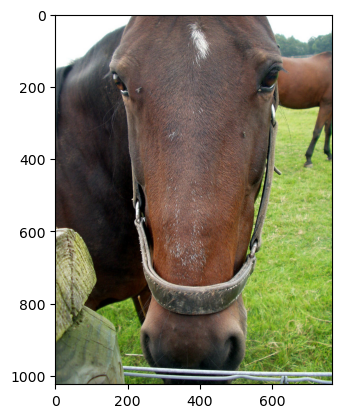

0.27849102 1


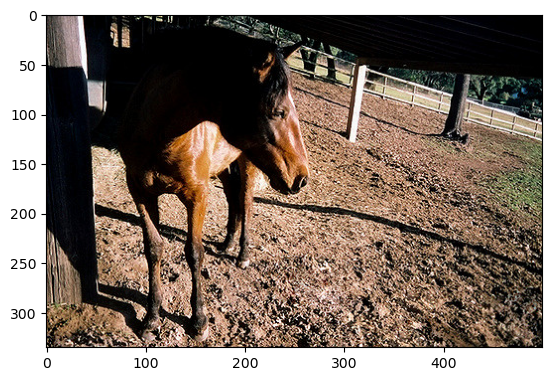

0.2839529 1


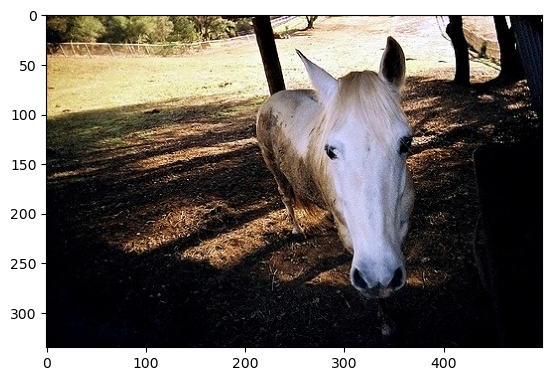

0.2736963 1


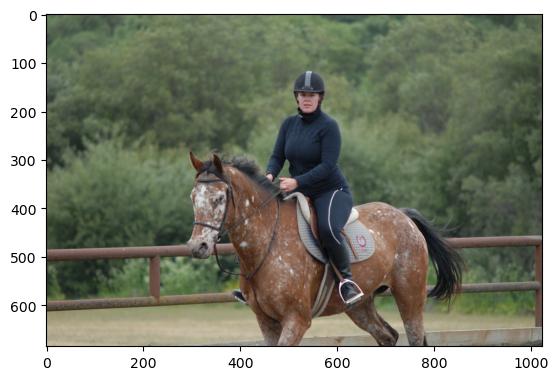

0.23932405 1


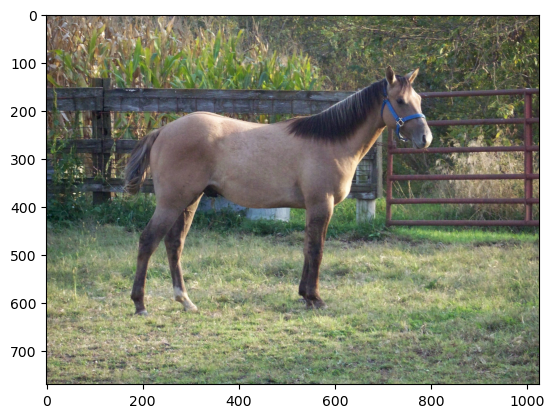

0.27942705 1


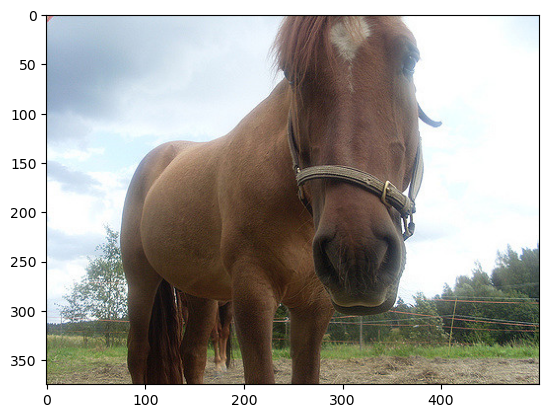

0.24369584 1


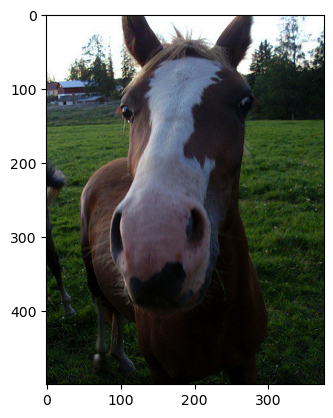

0.23187211 1


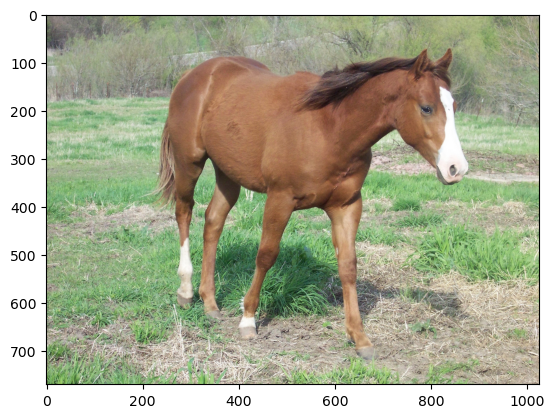

0.24298896 1


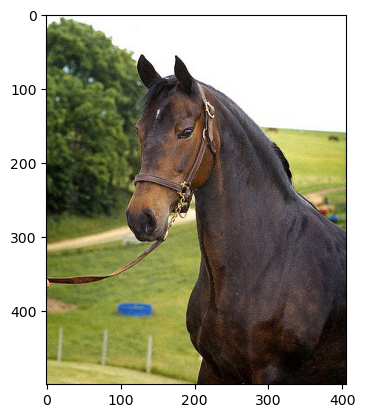

0.26722363 1


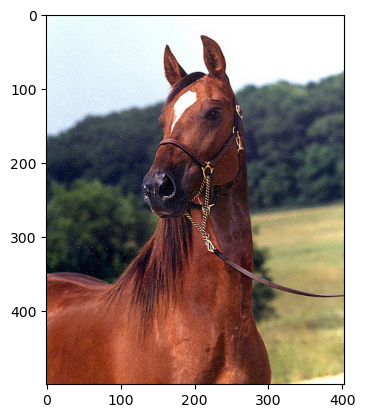

0.2408197 1


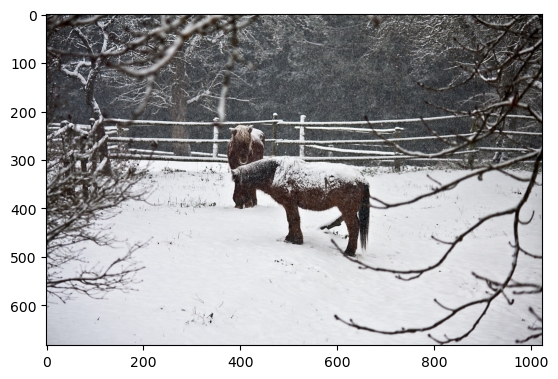

0.2249489 1


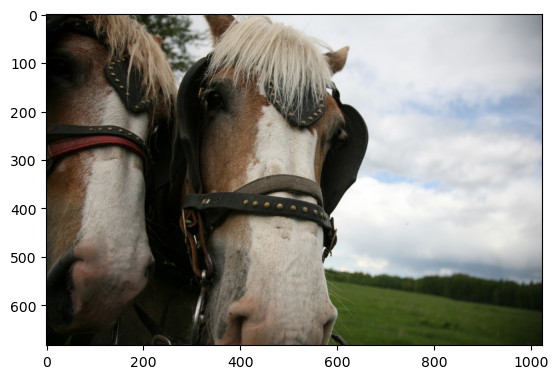

0.20409542 1


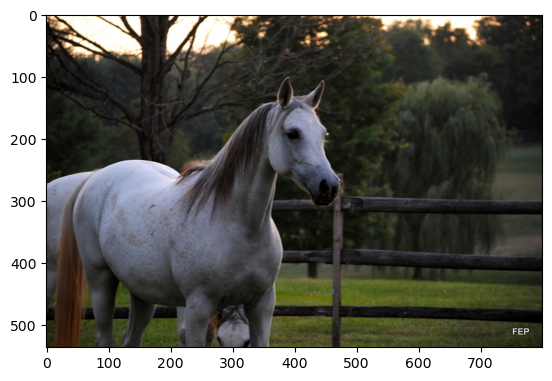

0.23646142 1


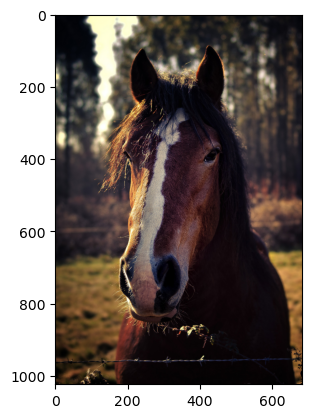

0.26492447 1


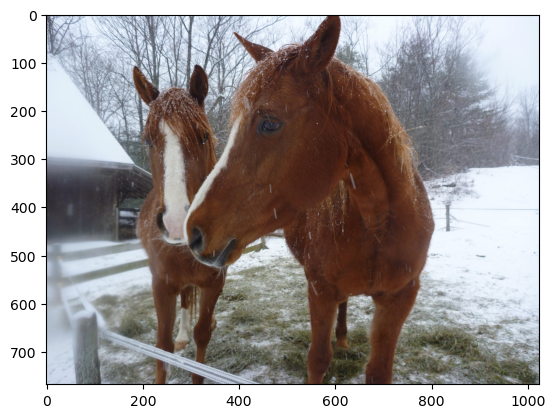

0.19101602 1


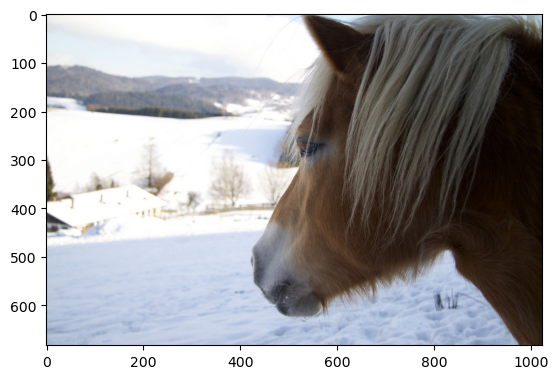

0.24400027 1


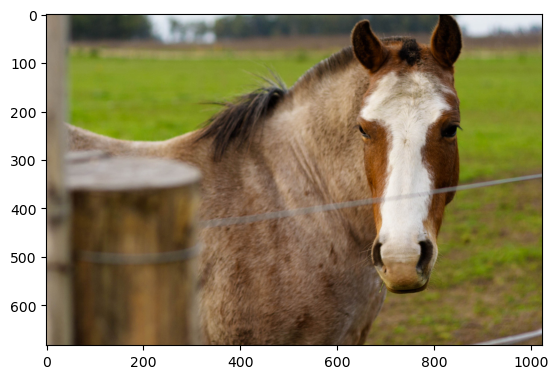

0.24567759 1


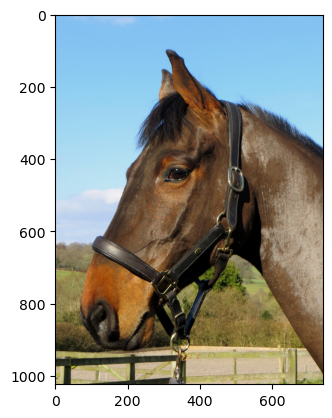

0.24562564 1


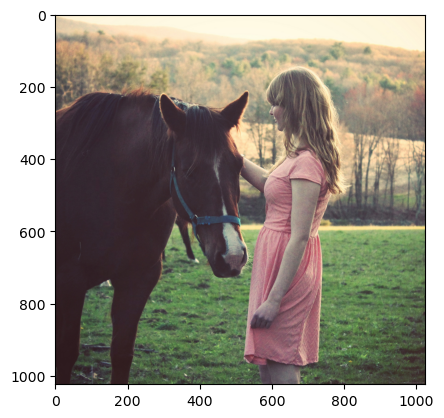

0.2115018 1


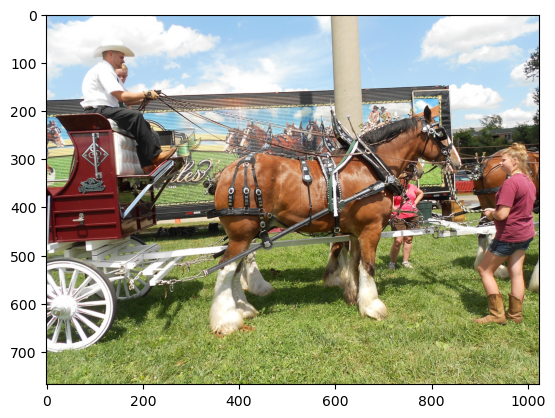

0.18140624 1


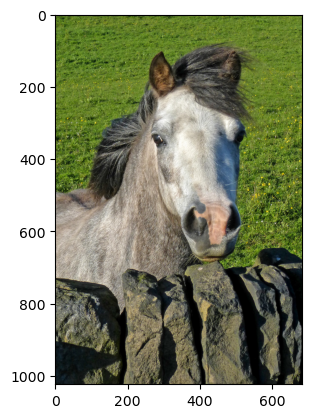

0.24639806 1


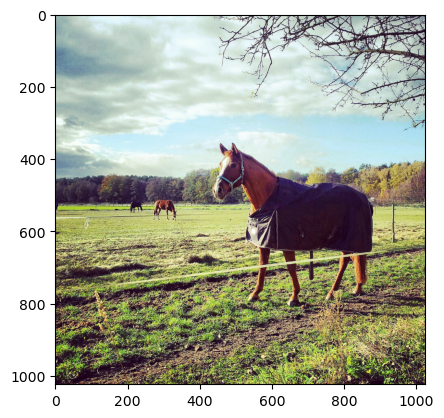

0.23047104 1


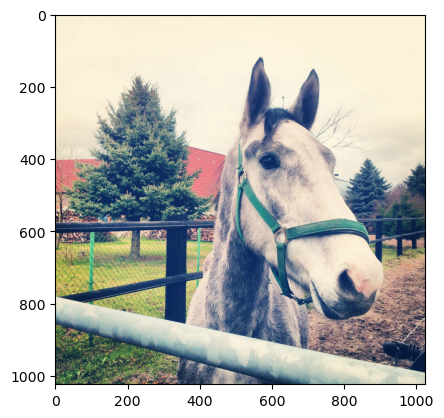

0.22404322 1


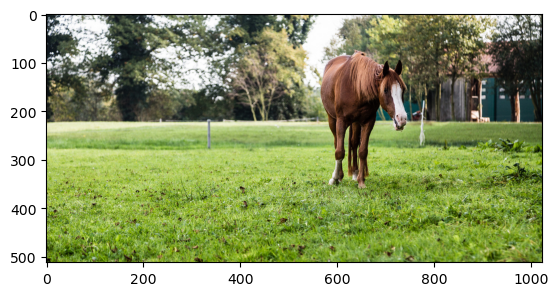

0.22494799 1


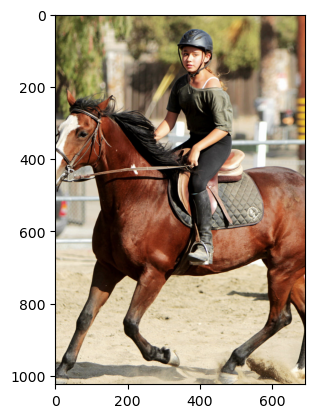

0.26849627 1


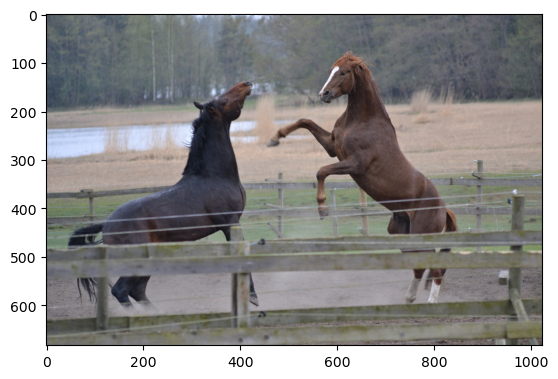

0.24524152 1


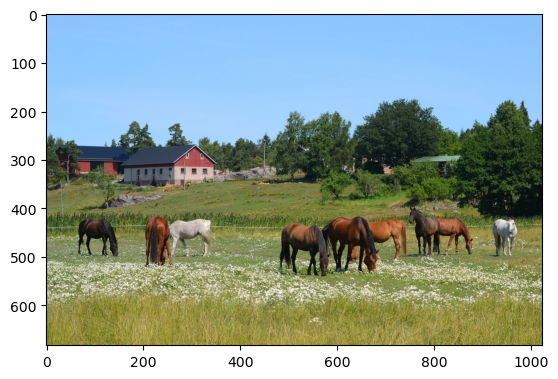

0.21853569 1


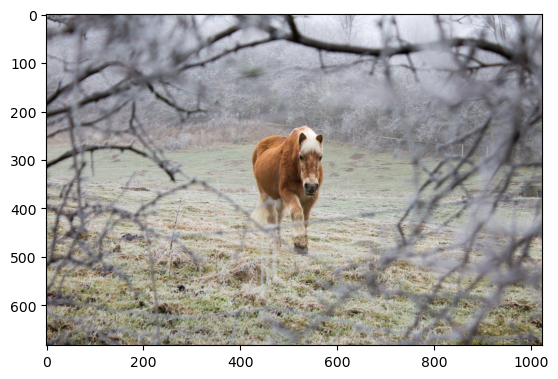

0.2448041 1


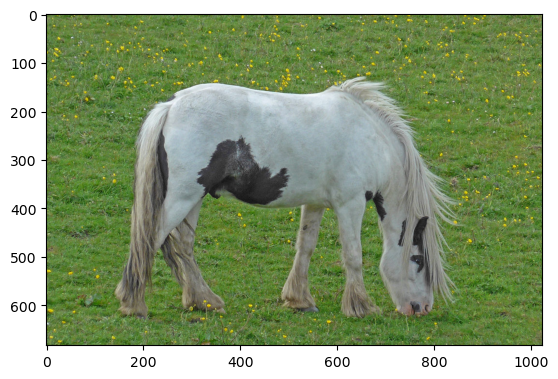

0.27170122 1


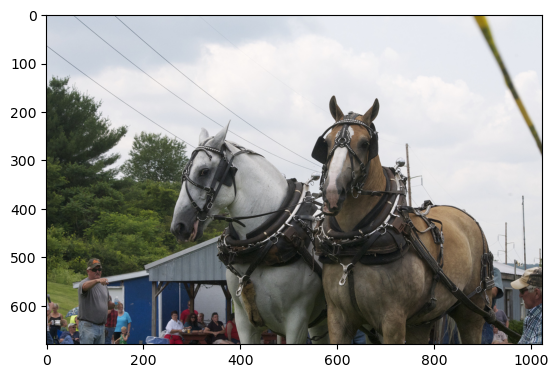

0.19947682 1


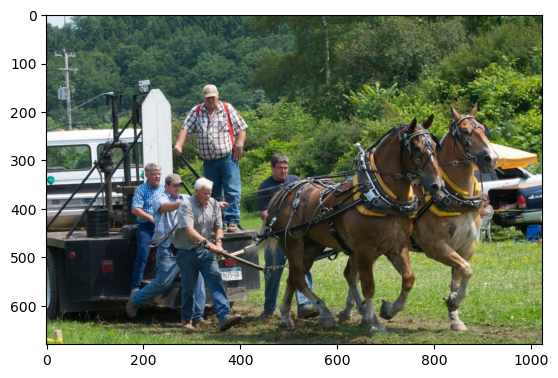

0.2188992 1


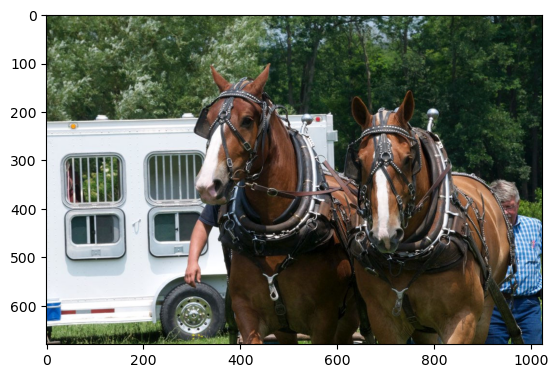

0.21905431 1


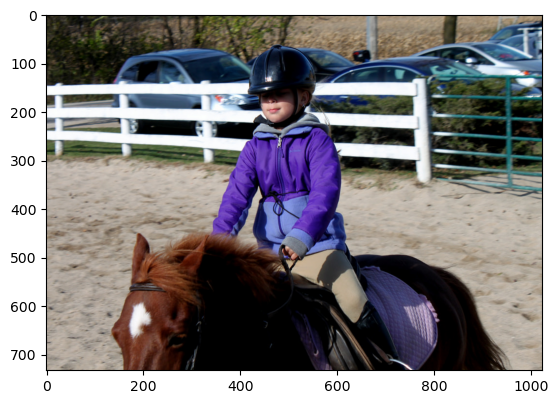

0.20883162 1


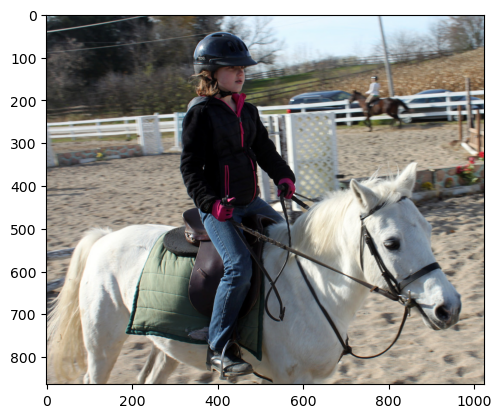

0.20895857 1


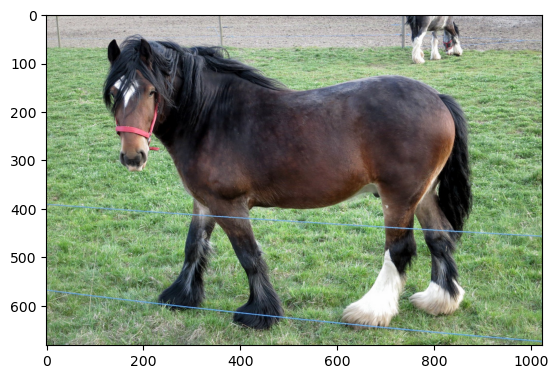

0.28169063 1


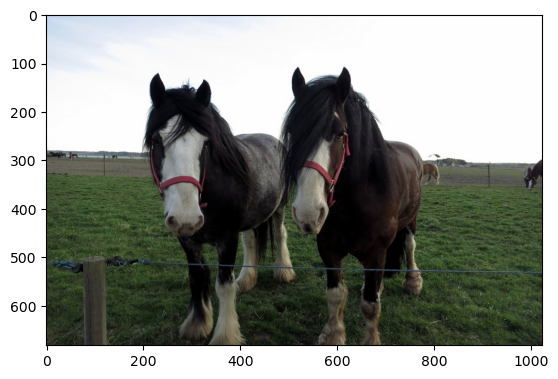

0.19739689 1


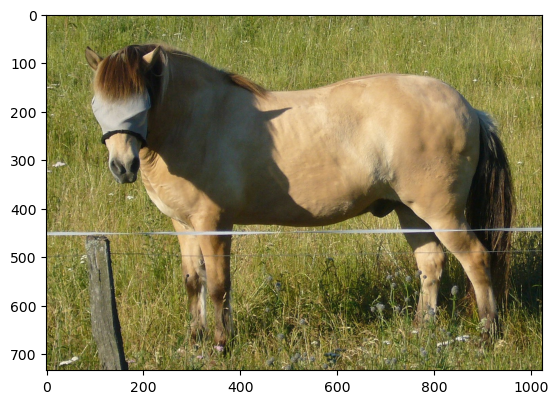

0.27011746 1


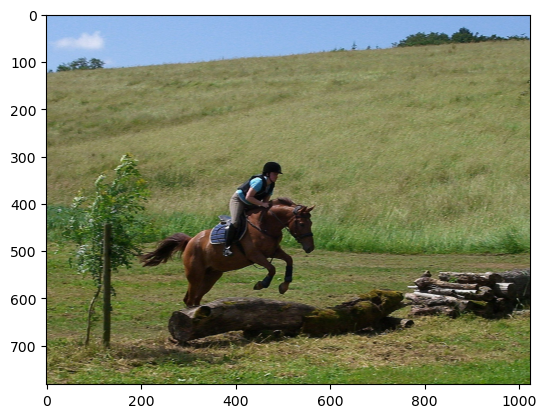

0.22421755 1


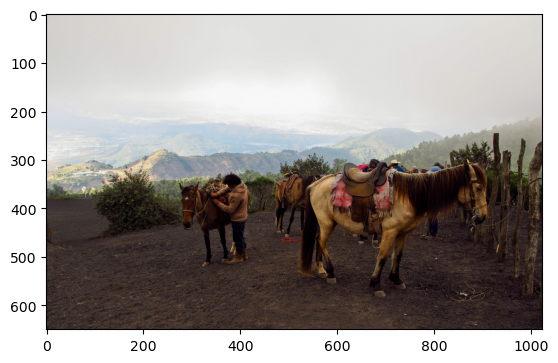

0.21955666 1


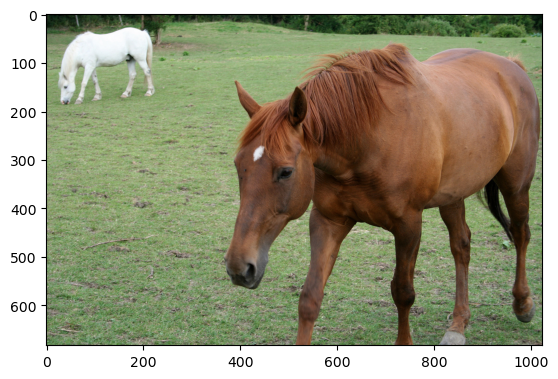

0.2583144 1


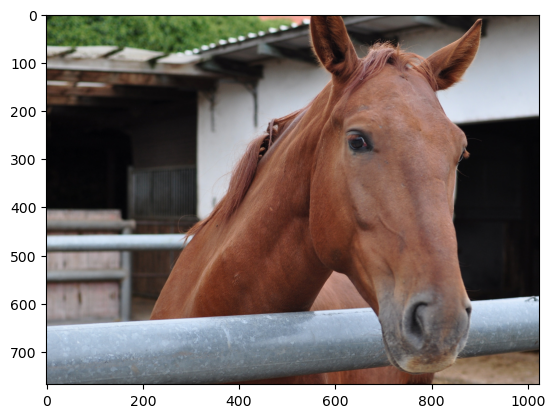

0.2596479 1


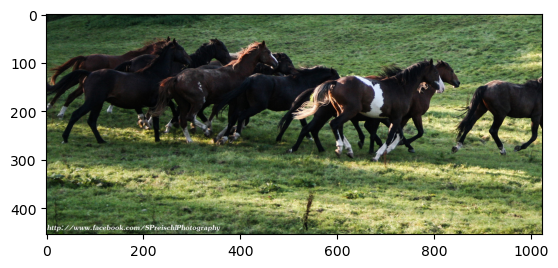

0.25237864 1


In [116]:
for i, zero_shot_c in enumerate(zero_shot_cs):
    if i < 900:
        continue
    if i > 1000:
        break
    
    plt.imshow(dset[i][0])
    plt.show()
    print(zero_shot_c[0], dset[i][1][0].item())

In [61]:
zero_shot_class_weights = np.load('./prompts/AwA2_class/template_prompts.npy')
zero_shot_class_weights.shape

(50, 512)

In [62]:
zero_shot_ys = emb_xs @ zero_shot_class_weights.T
zero_shot_ys.shape

(7481, 50)

In [64]:
ys

array([ 0,  0,  0, ..., 49, 49, 49])

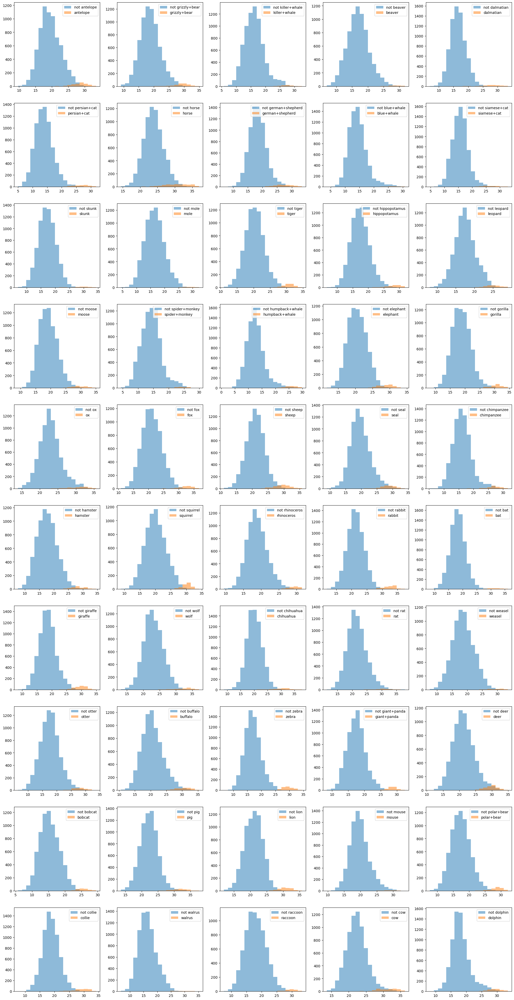

In [65]:
fig, axs = plt.subplots(10, 5, figsize=(5 * 5, 5 * 10))
for i, ax in enumerate(axs.flat):
    bins = np.linspace(zero_shot_ys[:, i].min(), zero_shot_ys[:, i].max(), 20)
    ax.hist(zero_shot_ys[:, i][ys != i], alpha=0.5, bins=bins, label=f"not {dset.class_names[i]}")
    ax.hist(zero_shot_ys[:, i][ys == i], alpha=0.5, bins=bins, label=dset.class_names[i])
    ax.legend()

In [67]:
np.mean(ys == zero_shot_ys.argmax(-1))

0.8310386311990375